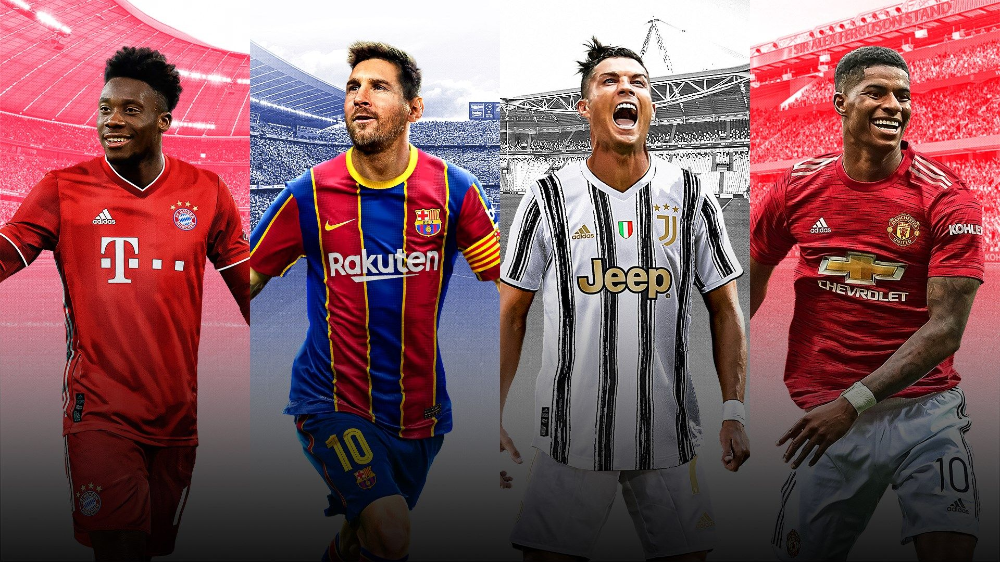
# DATA ANALYSIS OF PRO-EVOLUTION SOCCER 2021

 -This dataset was gotten from kaggle (https://www.kaggle.com/homerkommrad/efootball-pes2021-all-players-csv).It includes a detailed list of the players on PES 2021 as well as their attributes such as finishing,heading,dribbling.
 -The goal is to analyse and find out:
 - TOP 10 PLAYERS IN PES 2021
 -Best strikers
 -Best winger
 -Best attacking midfielder
 -best central midfielder
 -Best defensive midfielder
 -Best central defender
 -Best fullbacks
 -The top countries represented 
 -The correlation between age and speed 
 -Distribution of ball colour 
 -Also to ask some interesting questions with
 [Data Analysis with Python: Zero to Pandas](zerotopandas.com)
 

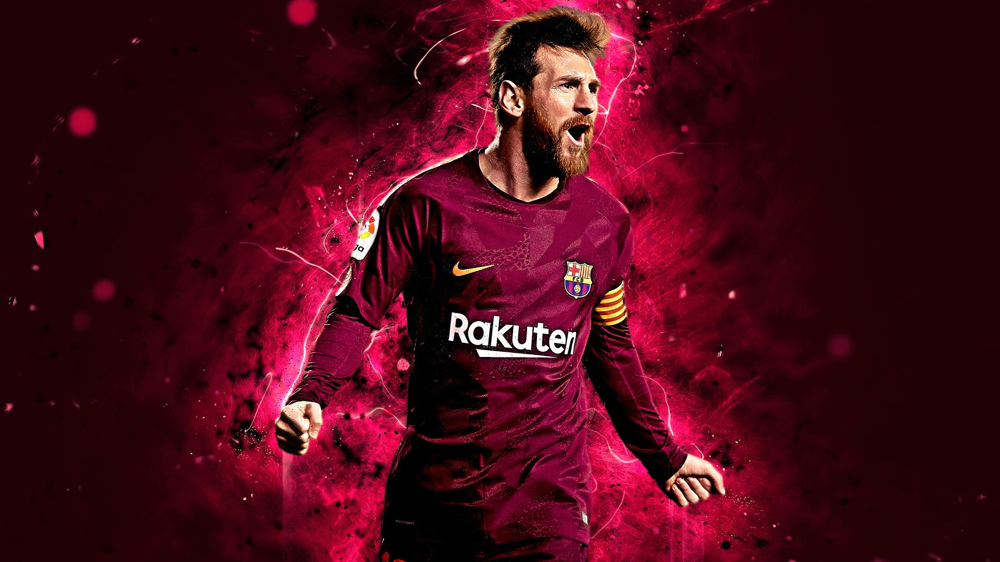



### How to run the code

This is an executable [*Jupyter notebook*](https://jupyter.org) hosted on [Jovian.ml](https://www.jovian.ml), a platform for sharing data science projects. You can run and experiment with the code in a couple of ways: *using free online resources* (recommended) or *on your own computer*.

#### Option 1: Running using free online resources (1-click, recommended)

The easiest way to start executing this notebook is to click the "Run" button at the top of this page, and select "Run on Binder". This will run the notebook on [mybinder.org](https://mybinder.org), a free online service for running Jupyter notebooks. You can also select "Run on Colab" or "Run on Kaggle".


#### Option 2: Running on your computer locally

1. Install Conda by [following these instructions](https://conda.io/projects/conda/en/latest/user-guide/install/index.html). Add Conda binaries to your system `PATH`, so you can use the `conda` command on your terminal.

2. Create a Conda environment and install the required libraries by running these commands on the terminal:

```
conda create -n zerotopandas -y python=3.8 
conda activate zerotopandas
pip install jovian jupyter numpy pandas matplotlib seaborn opendatasets --upgrade
```

3. Press the "Clone" button above to copy the command for downloading the notebook, and run it on the terminal. This will create a new directory and download the notebook. The command will look something like this:

```
jovian clone notebook-owner/notebook-id
```



4. Enter the newly created directory using `cd directory-name` and start the Jupyter notebook.

```
jupyter notebook
```

You can now access Jupyter's web interface by clicking the link that shows up on the terminal or by visiting http://localhost:8888 on your browser. Click on the notebook file (it has a `.ipynb` extension) to open it.


## Downloading the Dataset



In [20]:
!pip install jovian opendatasets --upgrade --quiet

Let's begin by downloading the data, and listing the files within the dataset.

In [21]:
# Change this
dataset_url = 'https://www.kaggle.com/homerkommrad/efootball-pes2021-all-players-csv/version/1' 

In [22]:
import opendatasets as od
od.download(dataset_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: adex12
Your Kaggle Key: ········


100%|██████████| 1.07M/1.07M [00:00<00:00, 46.4MB/s]

The dataset has been downloaded and extracted.

In [24]:
# Change this
data_dir = './efootball-pes2021-all-players-csv'

In [25]:
import os
os.listdir(data_dir)

['pes2021-all-players.csv']

Let us save and upload our work to Jovian before continuing.

In [42]:
project_name = "./efootball-pes2021-all-players-csv" # change this (use lowercase letters and hyphens only)

In [25]:
!pip install jovian --upgrade -q

In [43]:
import jovian

In [44]:
jovian.commit(project=project_name)

<IPython.core.display.Javascript object>

[jovian] Creating a new project "adedoyinadegbite-s/efootball-pes2021-all-players-csv"
[jovian] Committed successfully! https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0


'https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0'

## Data Preparation and Cleaning





In [27]:
import numpy as np
import pandas as pd


In [28]:
pes_df = pd.read_csv('pes2021-all-players.csv'  ) 

In [29]:
type(pes_df)

pandas.core.frame.DataFrame

In [16]:

pes_df

,name,shirt_number,team_name,league,nationality,region,height,weight,age,foot,...,skill_super_sub,com_playing_style_trickster,com_playing_style_mazing_run,com_playing_style_speeding_bullet,com_playing_style_incisive_run,com_playing_style_early_cross,com_playing_style_long_ball_expert,com_playing_style_long_ranger,ball_color,rating_stars
0,L. MESSI,10,FC BARCELONA,Spanish League,ARGENTINA,South America,170,72,33,Left foot,...,0,1,1,1,1,1,0,0,black,5
1,C. RONALDO,7,JUVENTUS,Serie A TIM,PORTUGAL,Europe,187,83,35,Right foot,...,0,1,1,1,1,0,0,1,black,5
2,R. LEWANDOWSKI,9,FC BAYERN MÜNCHEN,Other European Leagues,POLAND,Europe,185,79,32,Right foot,...,0,0,0,0,1,0,0,0,black,5
3,NEYMAR,10,PSG,Ligue 1 Uber Eats,BRAZIL,South America,175,68,28,Right foot,...,0,1,1,1,1,0,0,0,black,5
4,K. DE BRUYNE,17,MANCHESTER B,English League,BELGIUM,Europe,181,68,29,Right foot,...,0,0,1,0,0,1,1,1,black,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14688,ABDALLAH HAROUN S.,33,AL DUHAIL,AFC Champions League,QATAR,Asia-Oceania,170,68,20,Right foot,...,0,0,0,0,0,0,0,0,white,1
14689,S. SULEIMAN,50,SHABAB AL AHLI DUBAI,AFC Champions League,COMOROS,Africa,177,71,21,Right foot,...,0,0,0,0,0,0,0,0,white,1
14690,KHALIFA YOUSUF ATIQ,66,SHABAB AL AHLI DUBAI,AFC Champions League,UNITED ARAB EMIRATES,Asia-Oceania,176,72,18,Right foot,...,0,0,1,0,0,0,0,0,white,1
14691,T. RAKBUN,80,BG PATHUM UNITED,TOYOTA Thai League,THAILAND,Asia-Oceania,166,68,23,Right foot,...,0,0,0,0,0,0,0,0,white,1


To check if any if the values are Nan 

In [25]:
pes_df.info

<bound method DataFrame.info of                       name shirt_number             team_name  \
0                 L. MESSI           10          FC BARCELONA   
1               C. RONALDO            7              JUVENTUS   
2           R. LEWANDOWSKI            9     FC BAYERN MÜNCHEN   
3                   NEYMAR           10                   PSG   
4             K. DE BRUYNE           17          MANCHESTER B   
...                    ...          ...                   ...   
14688   ABDALLAH HAROUN S.           33             AL DUHAIL   
14689          S. SULEIMAN           50  SHABAB AL AHLI DUBAI   
14690  KHALIFA YOUSUF ATIQ           66  SHABAB AL AHLI DUBAI   
14691            T. RAKBUN           80      BG PATHUM UNITED   
14692         D. CORNELIUS           26            MOTHERWELL   

                       league           nationality         region  height  \
0              Spanish League             ARGENTINA  South America     170   
1                 Serie A TIM  

In [29]:
pes_df.describe

<bound method NDFrame.describe of                       name shirt_number             team_name  \
0                 L. MESSI           10          FC BARCELONA   
1               C. RONALDO            7              JUVENTUS   
2           R. LEWANDOWSKI            9     FC BAYERN MÜNCHEN   
3                   NEYMAR           10                   PSG   
4             K. DE BRUYNE           17          MANCHESTER B   
...                    ...          ...                   ...   
14688   ABDALLAH HAROUN S.           33             AL DUHAIL   
14689          S. SULEIMAN           50  SHABAB AL AHLI DUBAI   
14690  KHALIFA YOUSUF ATIQ           66  SHABAB AL AHLI DUBAI   
14691            T. RAKBUN           80      BG PATHUM UNITED   
14692         D. CORNELIUS           26            MOTHERWELL   

                       league           nationality         region  height  \
0              Spanish League             ARGENTINA  South America     170   
1                 Serie A TIM

There isn't any Nan value so we can begin our analysis of the data

In [27]:
pes_df.columns

Index(['name', 'shirt_number', 'team_name', 'league', 'nationality', 'region',
       'height', 'weight', 'age', 'foot',
       ...
       'skill_super_sub', 'com_playing_style_trickster',
       'com_playing_style_mazing_run', 'com_playing_style_speeding_bullet',
       'com_playing_style_incisive_run', 'com_playing_style_early_cross',
       'com_playing_style_long_ball_expert', 'com_playing_style_long_ranger',
       'ball_color', 'rating_stars'],
      dtype='object', length=120)

In [28]:
pes_df.shape

(14693, 120)

In [30]:
project_name = "Pro-evolution-soccer21"

In [34]:
!pip install jovian --upgrade -q

In [85]:
import jovian

In [86]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Updating notebook "adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0" on https://jovian.ai
[jovian] Committed successfully! https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0


'https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0'

## Exploratory Analysis and Visualization





Let's begin by importing`matplotlib.pyplot` and `seaborn`.

In [9]:
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (9, 5)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [10]:
for i in pes_df.columns:
    print (i)

name
shirt_number
team_name
league
nationality
region
height
weight
age
foot
condition
registered_position
LWF
SS
CF
RWF
LMF
DMF
CMF
AMF
RMF
LB
CB
RB
offensive_awareness
ball_control
dribbling
tight_possession
low_pass
lofted_pass
finishing
heading
place_kicking
curl
speed
acceleration
kicking_power
jump
physical_contact
balance
stamina
defensive_awareness
ball_winning
aggression
gk_awareness
gk_catching
gk_clearing
gk_reflexes
gk_reach
weak_foot_usage
weak_foot_accuracy
form
injury_resistance
overall_rating
rating_as_GK
rating_as_CB
rating_as_LB
rating_as_RB
rating_as_DMF
rating_as_CMF
rating_as_LMF
rating_as_RMF
rating_as_AMF
rating_as_LWF
rating_as_RWF
rating_as_SS
rating_as_CF
playing_style
skill_cross_over_turn
skill_early_cross
skill_first_time_shot
skill_incisive_run
skill_one_touch_pass
skill_chip_shot_control
skill_heel_trick
skill_man_marking
skill_interception
skill_gk_penalty_saver
skill_penalty_specialist
skill_step_on_skill_control
skill_rising_shots
skill_marseille_turn


In [14]:
pes_df.describe()

,height,weight,age,LWF,SS,CF,RWF,LMF,DMF,CMF,...,skill_no_look_pass,skill_super_sub,com_playing_style_trickster,com_playing_style_mazing_run,com_playing_style_speeding_bullet,com_playing_style_incisive_run,com_playing_style_early_cross,com_playing_style_long_ball_expert,com_playing_style_long_ranger,rating_stars
count,14693.000000,14693.000000,14693.000000,12982.000000,12982.000000,12982.000000,12982.000000,14693.000000,14693.000000,14693.000000,...,14693.000000,14693.000000,14693.000000,14693.000000,14693.000000,14693.000000,14693.000000,14693.00000,14693.000000,14693.000000
mean,180.816647,74.439189,25.660859,0.440071,0.425743,0.491681,0.436373,0.468727,0.464030,0.614442,...,0.008848,0.043422,0.099027,0.173484,0.150548,0.142789,0.122099,0.17117,0.205812,1.618254
std,6.784317,6.848696,4.849386,0.731650,0.628394,0.806462,0.727853,0.694328,0.727519,0.837896,...,0.093649,0.203812,0.298708,0.378678,0.357620,0.349870,0.327411,0.37667,0.404308,0.884178
min,156.000000,40.000000,15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,1.000000
25%,176.000000,70.000000,22.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,1.000000
50%,180.000000,74.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,1.000000
75%,186.000000,79.000000,29.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,2.000000
max,203.000000,113.000000,43.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,5.000000


From the above description>>> 
The range of height(cm) is between 156 to 203
The range of weight(kg) is between 40 to 113
The range of age is between 15 to 43


## The Countries that is most represented 

In [56]:
#first we check all the countries listed 
pes_df.nationality


0                   ARGENTINA
1                    PORTUGAL
2                      POLAND
3                      BRAZIL
4                     BELGIUM
                 ...         
14688                   QATAR
14689                 COMOROS
14690    UNITED ARAB EMIRATES
14691                THAILAND
14692                SCOTLAND
Name: nationality, Length: 14693, dtype: object

In [58]:
#then we sort based on value
country_count_df=pes_df['nationality'].value_counts()
country_count_df

BRAZIL                 1439
SPAIN                   967
ARGENTINA               924
FRANCE                  907
ITALY                   779
                       ... 
LEBANON                   1
GUATEMALA                 1
MONTSERRAT                1
TRINIDAD AND TOBAGO       1
YEMEN                     1
Name: nationality, Length: 157, dtype: int64

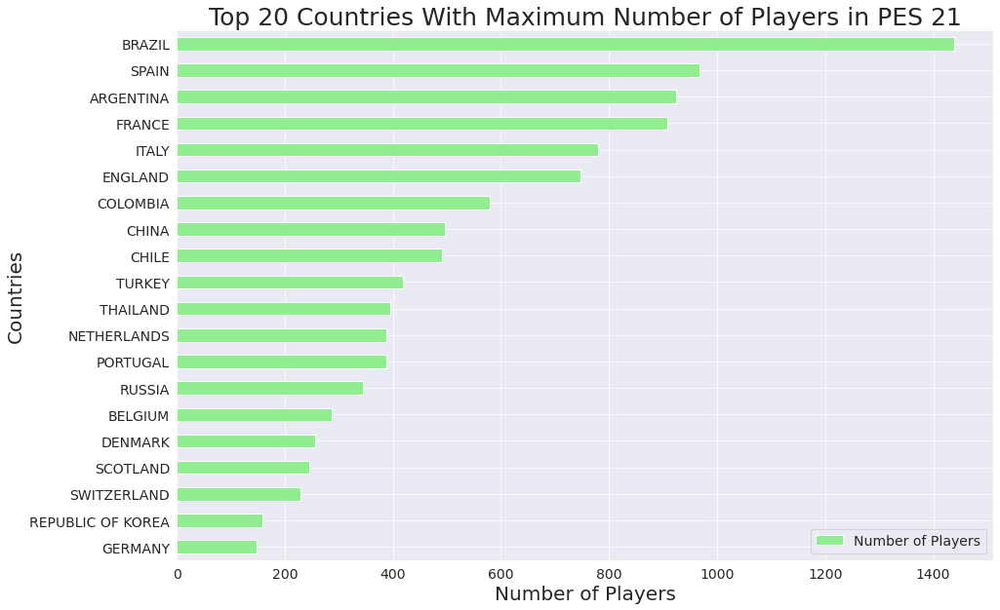

In [59]:
#then plot a graph to show each countries
country_df=pd.DataFrame(country_count_df.head(20))
country_df.sort_values('nationality',ascending=True).plot(kind='barh',figsize=(15,10),color='lightgreen')
plt.title('Top 20 Countries With Maximum Number of Players in PES 21',fontsize=25)
plt.ylabel('Countries',fontsize=20)
plt.xlabel('Number of Players',fontsize=20)
plt.legend(['Number of Players']);

Based on this,Brazil has the most players in PES 21

## Who are the fastest?

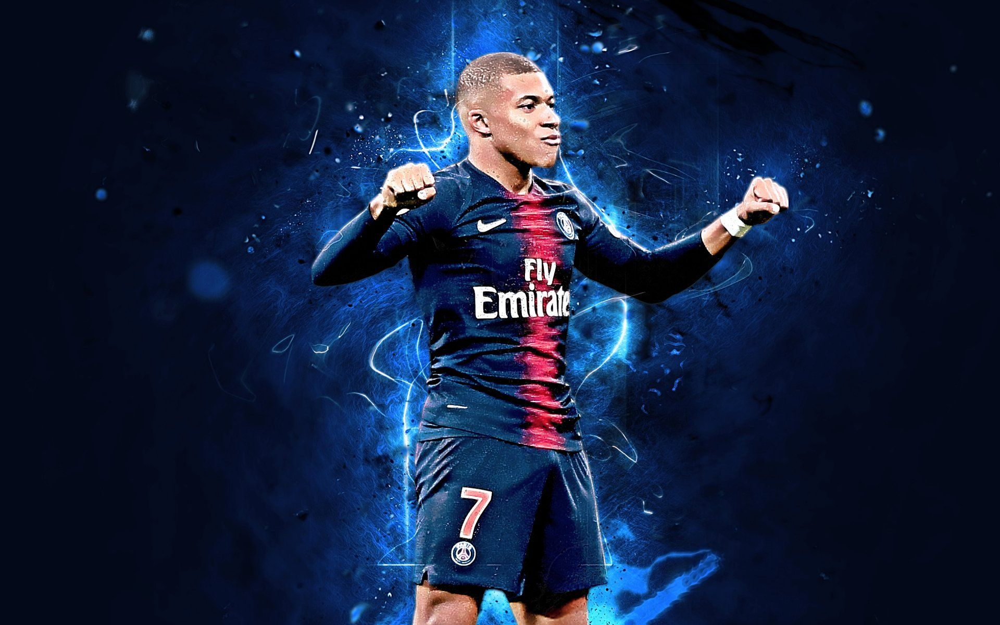

In [62]:
#first we create a dataframe based on the attritube'speed'
fast_df=pes_df[['name','overall_rating','speed','nationality','team_name','foot','age']]
fast_df.sort_values('speed',ascending=False).head(10)

,name,overall_rating,speed,nationality,team_name,foot,age
990,K. MBABU,78,96,SWITZERLAND,Free Agents,Right foot,25
71,L. SANÉ,86,96,GERMANY,FC BAYERN MÜNCHEN,Left foot,24
22,P. AUBAMEYANG,88,96,GABON,ARSENAL,Right foot,31
343,A. DAVIES,82,96,CANADA,FC BAYERN MÜNCHEN,Left foot,20
7,K. MBAPPÉ,91,96,FRANCE,PSG,Right foot,22
302,ADAMA TRAORÉ,82,96,SPAIN,WOLVERHAMPTON YB,Right foot,24
237,A. HAKIMI,83,95,MOROCCO,LOMBARDIA NA,Right foot,22
1628,F. ACHEAMPONG,76,95,GHANA,TIANJIN TEDA,Left foot,27
1050,D. JAMES,78,94,WALES,MANCHESTER UNITED,Right foot,23
10,S. MANÉ,90,94,SENEGAL,LIVERPOOL R,Right foot,28


In [61]:
#then we create a dataframe based on'acceleration'
fast2_df=pes_df[['name','overall_rating','speed','acceleration','nationality','team_name','foot','age']]
fast2_df.sort_values('acceleration',ascending=False).head(10)

,name,overall_rating,speed,acceleration,nationality,team_name,foot,age
7,K. MBAPPÉ,91,96,97,FRANCE,PSG,Right foot,22
302,ADAMA TRAORÉ,82,96,97,SPAIN,WOLVERHAMPTON YB,Right foot,24
28,R. STERLING,88,92,95,ENGLAND,MANCHESTER B,Right foot,26
407,A. SAINT-MAXIMIN,81,91,95,FRANCE,NEWCASTLE WB,Right foot,23
77,T. WERNER,86,92,95,GERMANY,CHELSEA B,Right foot,24
1999,C. ATSU,75,89,95,GHANA,NEWCASTLE WB,Left foot,28
10,S. MANÉ,90,94,95,SENEGAL,LIVERPOOL R,Right foot,28
811,M. DIABY,79,90,95,FRANCE,BAYER LEVERKUSEN,Left foot,21
1050,D. JAMES,78,94,95,WALES,MANCHESTER UNITED,Right foot,23
299,RAFA SILVA,82,93,94,PORTUGAL,BENFICA,Right foot,27


The fastest players are Mbappe and Adama based on their acceleration and speed

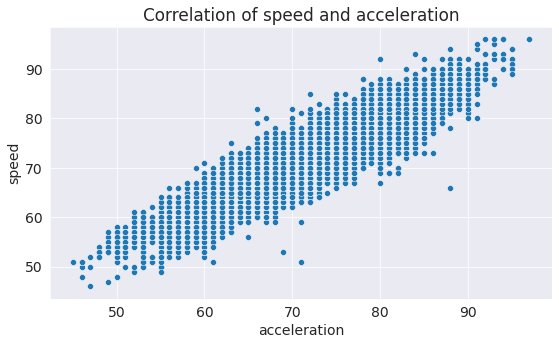

In [54]:
plt.title ('Correlation of speed and acceleration' )
sns.scatterplot(x=fast2_df.acceleration,y=fast2_df.speed);

the scatterplot is to show the correlation between speed and acceleration as the higher the acceleration the higher the speed 

## To Check The Correlation between Age and Speed

In [51]:
#first we combine the dataframes based on speed and acceleration
fast_combined_df=pd.concat([fast_df,fast2_df], axis=0)
fast_combined_df=fast_combined_df.drop_duplicates(subset='name')
combined_df=fast_combined_df.groupby('name')[['speed','age']].max()
combined_df=combined_df.sort_values('speed',ascending=False).head(20)
combined_df

,speed,age
name,,
A. DAVIES,96,20
P. AUBAMEYANG,96,31
K. MBABU,96,25
K. MBAPPÉ,96,22
ADAMA TRAORÉ,96,24
L. SANÉ,96,24
A. HAKIMI,95,22
F. ACHEAMPONG,95,27
D. JAMES,94,23


We see that the list of fastest players have changed because 6 players are now all first on the list

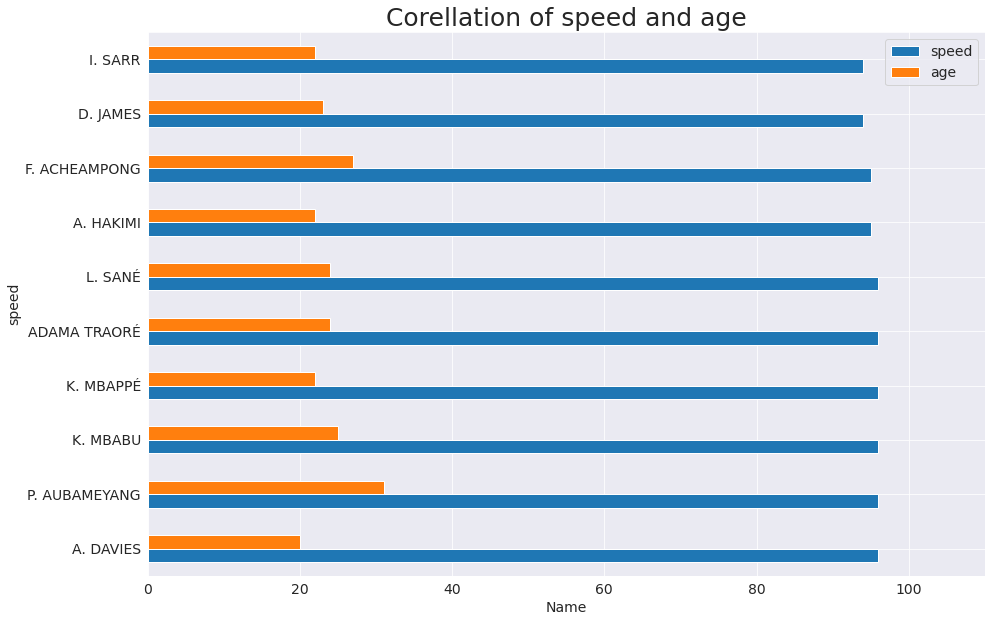

In [50]:
combined_df.plot(kind='barh',figsize=(15,10))
plt.title('Corellation of speed and age',fontsize=25)
plt.xlim(0,110,10)
plt.xlabel('Name')
plt.ylabel('speed')
plt.legend();


we can see by the graph that 90 percent of the fatest players are below 30


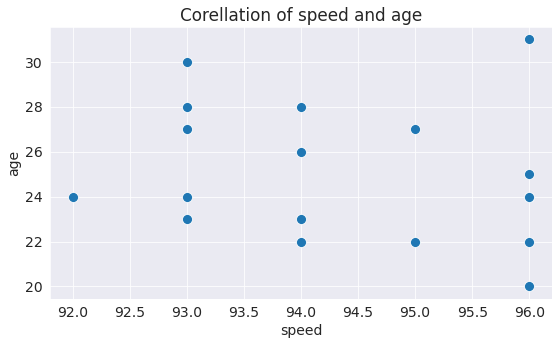

In [52]:
plt.title('Corellation of speed and age')
sns.scatterplot(x=combined_df.speed,y=combined_df.age,s=100);





the scatter plot is to show how age affects speed as the fastest players are majorly below 25 which support the fact that as a player ages they lose speed

## Distribution of Players in PES 21

In [24]:
#first we create a new dataframe 
ball_df=pes_df.groupby('ball_color')[['ball_color']].count()
ball_df




,ball_color
ball_color,
black,120
bronze,3541
gold,505
silver,1774
white,8753


In [30]:
dict={'black':120,'gold':505,'silver':1774,'bronze':3541,'white':8753}

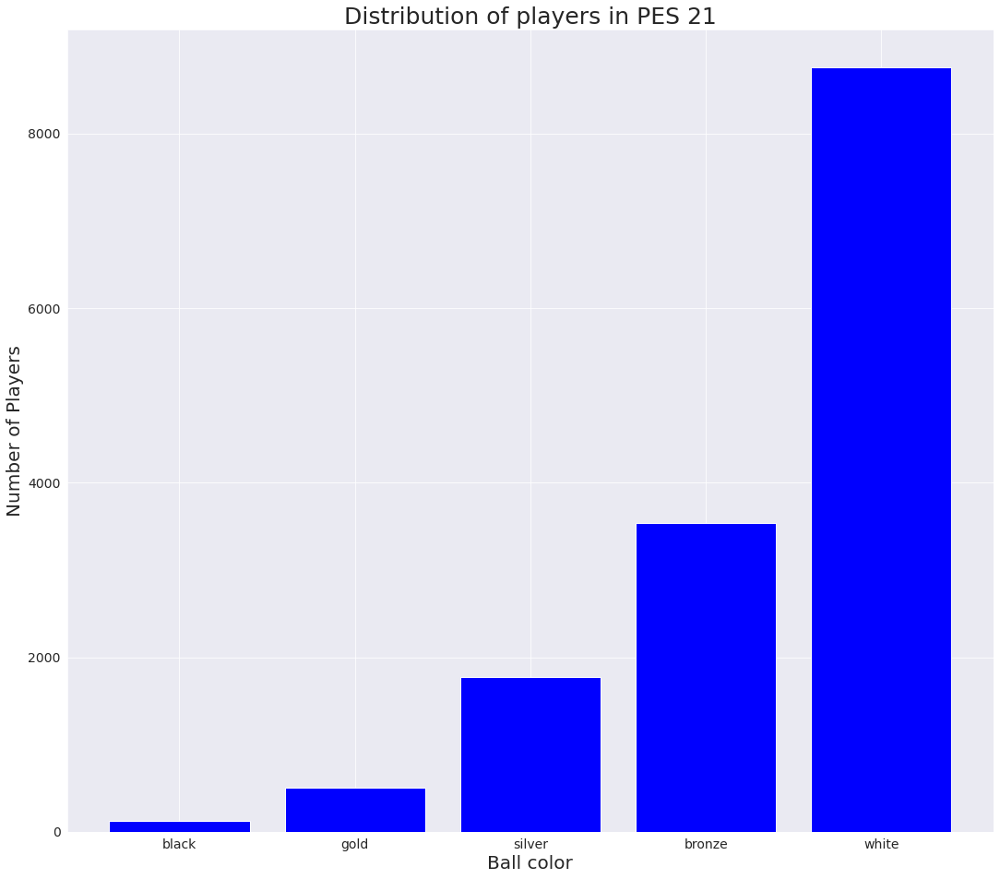

In [37]:
keys=dict.keys()
values=dict.values()
plt.figure(figsize=(18,16))
plt.xlabel('Ball color',fontsize=20)
plt.ylabel('Number of Players',fontsize=20)
plt.title('Distribution of players in PES 21',fontsize=25)
plt.bar(keys,values,color='b')
plt.show()

The Bar Chart shows the distribution of players and the rarity of black balled players

In [7]:
#To check possibility of getting a black balled player 
number_of_black_balled_players=120
numner_of_total_players=14693
possibility_df=number_of_black_balled_players /numner_of_total_players *100

In [15]:
print('the possibility of getting a black balled player is{}%.'.format(possibility_df))

the possibility of getting a black balled player is0.8167154427278296%.


 ## Skills in Correlation to Ball control

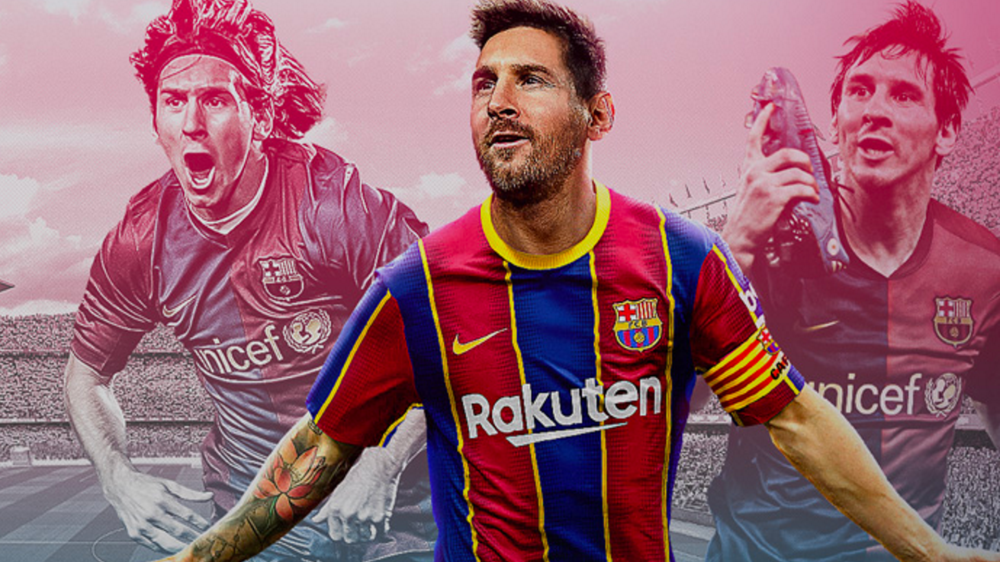

In [63]:
#we create a new dataframe based on dribbling
skill_df=pes_df[['name','overall_rating','dribbling','ball_control','nationality','team_name','foot','age']]
skill_df.sort_values('dribbling',ascending=False).head(20)

,name,overall_rating,dribbling,ball_control,nationality,team_name,foot,age
0,L. MESSI,94,97,96,ARGENTINA,FC BARCELONA,Left foot,33
3,NEYMAR,92,96,92,BRAZIL,PSG,Right foot,28
46,BERNARDO SILVA,87,95,94,PORTUGAL,MANCHESTER B,Left foot,26
20,E. HAZARD,88,95,91,BELGIUM,MADRID CHAMARTIN B,Right foot,29
7,K. MBAPPÉ,91,94,89,FRANCE,PSG,Right foot,22
78,J. SANCHO,86,93,89,ENGLAND,Free Agents,Right foot,20
129,DOUGLAS COSTA,84,92,86,BRAZIL,JUVENTUS,Left foot,30
462,VINÍCIUS JÚNIOR,81,92,84,BRAZIL,MADRID CHAMARTIN B,Right foot,20
97,ISCO,85,91,92,SPAIN,MADRID CHAMARTIN B,Right foot,28
67,R. MAHREZ,86,91,89,ALGERIA,MANCHESTER B,Left foot,29


MESSI IS THE BEST DRIBBLER


In [67]:

dribbling_list=pes_df['dribbling'].tolist
dribbling_list

<bound method IndexOpsMixin.tolist of 0        97
1        89
2        85
3        96
4        88
         ..
14688    59
14689    51
14690    63
14691    60
14692    50
Name: dribbling, Length: 14693, dtype: int64>

In [65]:
#we create a new dataframe based on ball control
ball_control_df=pes_df[['name','overall_rating','ball_control','nationality','team_name','foot','age']]
ball_control_df.sort_values('ball_control',ascending=False).head(20)

,name,overall_rating,ball_control,nationality,team_name,foot,age
0,L. MESSI,94,96,ARGENTINA,FC BARCELONA,Left foot,33
119,ANDRES INIESTA,85,94,SPAIN,VISSEL KOBE,Right foot,36
46,BERNARDO SILVA,87,94,PORTUGAL,MANCHESTER B,Left foot,26
60,J. ILIČIĆ,86,94,SLOVENIA,ATALANTA,Left foot,32
19,T. KROOS,88,94,GERMANY,MADRID CHAMARTIN B,Right foot,30
4,K. DE BRUYNE,92,92,BELGIUM,MANCHESTER B,Right foot,29
73,S. MILINKOVIĆ-SAVIĆ,86,92,SERBIA,LAZIO,Right foot,25
3,NEYMAR,92,92,BRAZIL,PSG,Right foot,28
160,SANTI CAZORLA,83,92,SPAIN,Free Agents,Right foot,36
52,L. MODRIĆ,86,92,CROATIA,MADRID CHAMARTIN B,Right foot,35


Messi is the best ball controller

In [68]:
skill_combined_df=pd.concat([skill_df,ball_control_df], axis=0)
skill_combined_df=skill_combined_df.drop_duplicates(subset='name')
s_combined_df=skill_combined_df.groupby('name')[['dribbling','ball_control']].max()
s_combined_df=s_combined_df.sort_values('dribbling',ascending=False).head(20)
s_combined_df

,dribbling,ball_control
name,,
L. MESSI,97.0,96
NEYMAR,96.0,92
E. HAZARD,95.0,91
BERNARDO SILVA,95.0,94
K. MBAPPÉ,94.0,89
J. SANCHO,93.0,89
VINÍCIUS JÚNIOR,92.0,84
DOUGLAS COSTA,92.0,86
ISCO,91.0,92


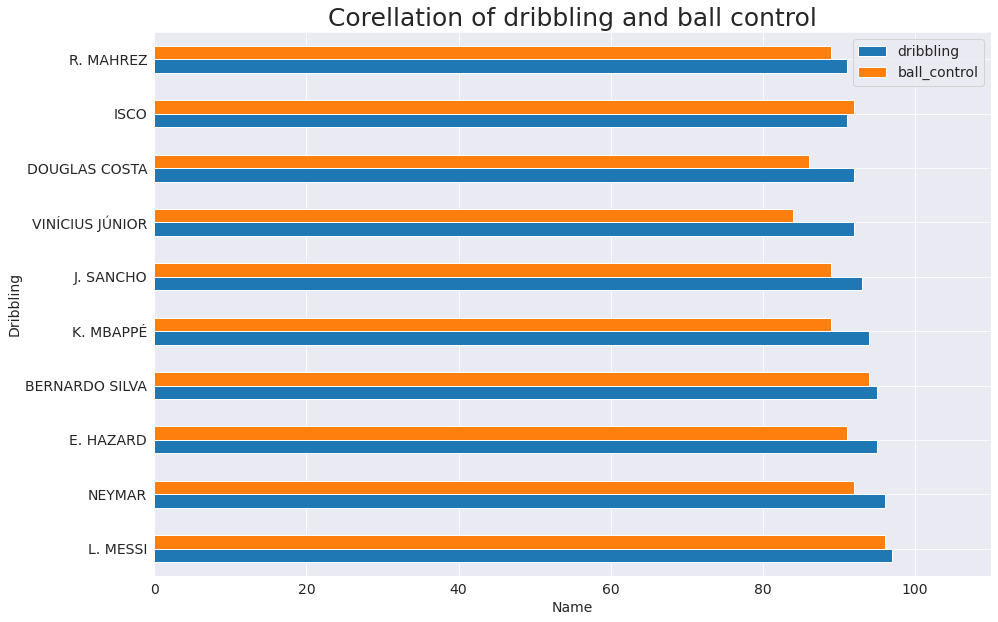

In [67]:
s_combined_df.plot(kind='barh',figsize=(15,10))
plt.title('Corellation of dribbling and ball control',fontsize=25)
plt.xlim(0,110,10)
plt.xlabel('Name')
plt.ylabel('Dribbling')
plt.legend();

The Bar chart is to show how skillful a player is based on their level of dribling and ball control and  Messi is the most skillful player

Let us save and upload our work to Jovian before continuing

In [94]:
import jovian

In [95]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Updating notebook "adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0" on https://jovian.ai
[jovian] Committed successfully! https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0


'https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0'

# Finding out interesting questions about the data

-Top 10 players in each position
    -Top 10 right wingers
    -Top 10 left wingers
    -Top 10 second strikers
    -Top 10 Strikers
    -Top 10 central midfielders
    -Top 10 attacking midfielders
    -Top 10 left midfielders
    -Top 10 right midfielders
    -Top 10 Defensice midfielders
    -Top 10 center backs
    -Top 10 left backs
    -Top 10 right backs
    -Top 10 goalkeepers
 -Who the deadliest finisher is 
 -The best target man
 -The best header
 -who the best player is in the game and the must have 

## TOP 10 PLAYERS IN PES 2021


FIND OUT THE TOP 10 PLAYERS

In [38]:
for i in pes_df.columns:
    print (i)

name
shirt_number
team_name
league
nationality
region
height
weight
age
foot
condition
registered_position
LWF
SS
CF
RWF
LMF
DMF
CMF
AMF
RMF
LB
CB
RB
offensive_awareness
ball_control
dribbling
tight_possession
low_pass
lofted_pass
finishing
heading
place_kicking
curl
speed
acceleration
kicking_power
jump
physical_contact
balance
stamina
defensive_awareness
ball_winning
aggression
gk_awareness
gk_catching
gk_clearing
gk_reflexes
gk_reach
weak_foot_usage
weak_foot_accuracy
form
injury_resistance
overall_rating
rating_as_GK
rating_as_CB
rating_as_LB
rating_as_RB
rating_as_DMF
rating_as_CMF
rating_as_LMF
rating_as_RMF
rating_as_AMF
rating_as_LWF
rating_as_RWF
rating_as_SS
rating_as_CF
playing_style
skill_cross_over_turn
skill_early_cross
skill_first_time_shot
skill_incisive_run
skill_one_touch_pass
skill_chip_shot_control
skill_heel_trick
skill_man_marking
skill_interception
skill_gk_penalty_saver
skill_penalty_specialist
skill_step_on_skill_control
skill_rising_shots
skill_marseille_turn


In [49]:
#finding the best 10 players
pes_df.head(10)

,name,shirt_number,team_name,league,nationality,region,height,weight,age,foot,...,skill_super_sub,com_playing_style_trickster,com_playing_style_mazing_run,com_playing_style_speeding_bullet,com_playing_style_incisive_run,com_playing_style_early_cross,com_playing_style_long_ball_expert,com_playing_style_long_ranger,ball_color,rating_stars
0,L. MESSI,10,FC BARCELONA,Spanish League,ARGENTINA,South America,170,72,33,Left foot,...,0,1,1,1,1,1,0,0,black,5
1,C. RONALDO,7,JUVENTUS,Serie A TIM,PORTUGAL,Europe,187,83,35,Right foot,...,0,1,1,1,1,0,0,1,black,5
2,R. LEWANDOWSKI,9,FC BAYERN MÜNCHEN,Other European Leagues,POLAND,Europe,185,79,32,Right foot,...,0,0,0,0,1,0,0,0,black,5
3,NEYMAR,10,PSG,Ligue 1 Uber Eats,BRAZIL,South America,175,68,28,Right foot,...,0,1,1,1,1,0,0,0,black,5
4,K. DE BRUYNE,17,MANCHESTER B,English League,BELGIUM,Europe,181,68,29,Right foot,...,0,0,1,0,0,1,1,1,black,5
5,J. OBLAK,13,MADRID ROSAS RB,Spanish League,SLOVENIA,Europe,188,87,27,Right foot,...,0,0,0,0,0,0,0,0,black,5
6,V. VAN DIJK,4,LIVERPOOL R,English League,NETHERLANDS,Europe,193,92,29,Right foot,...,0,0,0,0,0,0,1,0,black,5
7,K. MBAPPÉ,7,PSG,Ligue 1 Uber Eats,FRANCE,Europe,178,73,22,Right foot,...,0,1,1,1,1,0,0,0,black,5
8,SERGIO RAMOS,4,MADRID CHAMARTIN B,Spanish League,SPAIN,Europe,184,82,34,Right foot,...,0,0,0,0,0,0,1,1,black,5
9,S. AGÜERO,10,MANCHESTER B,English League,ARGENTINA,South America,173,70,32,Right foot,...,0,0,1,1,0,0,0,0,black,5


The top rated player is Messi

## BEST LEFT  WINGERS


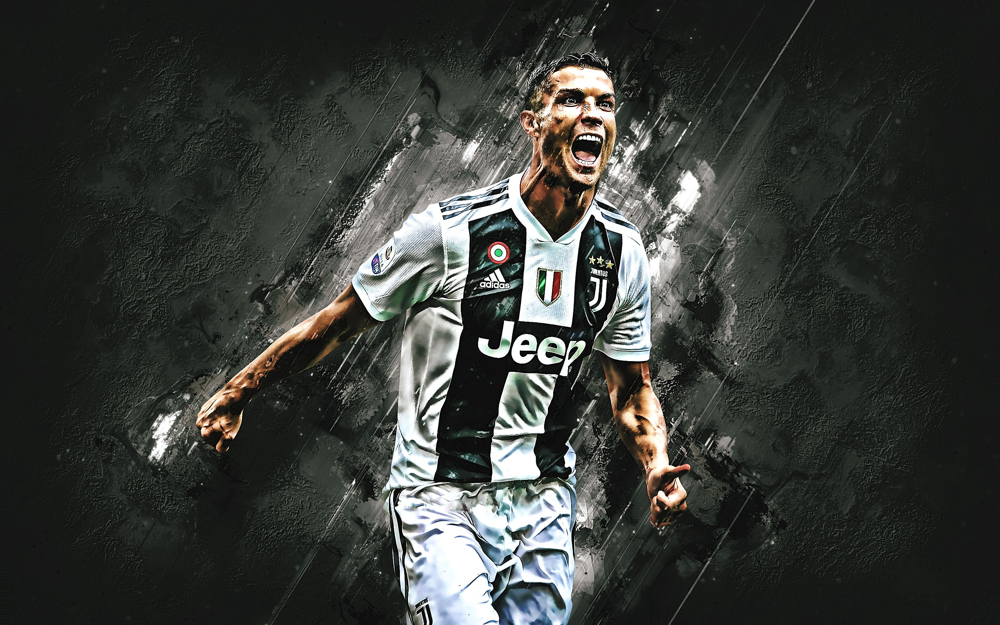

In [97]:
left_wingers_df=pes_df[['name','overall_rating','rating_as_LWF','nationality','team_name','foot','age']]
left_wingers_df.sort_values('rating_as_LWF',ascending=False).head(20)

,name,overall_rating,rating_as_LWF,nationality,team_name,foot,age
1,C. RONALDO,93,93,PORTUGAL,JUVENTUS,Right foot,35
3,NEYMAR,92,92,BRAZIL,PSG,Right foot,28
10,S. MANÉ,90,90,SENEGAL,LIVERPOOL R,Right foot,28
0,L. MESSI,94,89,ARGENTINA,FC BARCELONA,Left foot,33
7,K. MBAPPÉ,91,88,FRANCE,PSG,Right foot,22
20,E. HAZARD,88,88,BELGIUM,MADRID CHAMARTIN B,Right foot,29
28,R. STERLING,88,88,ENGLAND,MANCHESTER B,Right foot,26
25,A. GRIEZMANN,88,88,FRANCE,FC BARCELONA,Left foot,29
43,S. GNABRY,87,87,GERMANY,FC BAYERN MÜNCHEN,Right foot,25
71,L. SANÉ,86,86,GERMANY,FC BAYERN MÜNCHEN,Left foot,24


C-Ronaldo is the GOAT

## BEST RIGHT WINGERS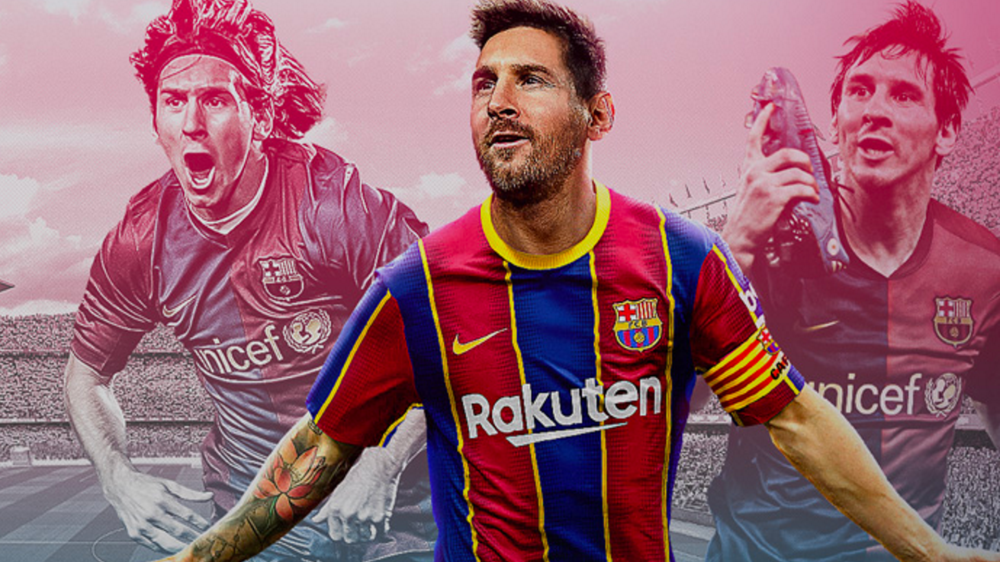

In [41]:
right_wingers_df=pes_df[['name','overall_rating','rating_as_RWF','nationality','team_name','foot','age']]
right_wingers_df.sort_values('rating_as_RWF',ascending=False).head(20)

,name,overall_rating,rating_as_RWF,nationality,team_name,foot,age
0,L. MESSI,94,94,ARGENTINA,FC BARCELONA,Left foot,33
16,M. SALAH,89,89,EGYPT,LIVERPOOL R,Left foot,28
7,K. MBAPPÉ,91,88,FRANCE,PSG,Right foot,22
46,BERNARDO SILVA,87,87,PORTUGAL,MANCHESTER B,Left foot,26
35,Á. DI MARÍA,87,87,ARGENTINA,PSG,Left foot,32
1,C. RONALDO,93,87,PORTUGAL,JUVENTUS,Right foot,35
3,NEYMAR,92,86,BRAZIL,PSG,Right foot,28
28,R. STERLING,88,86,ENGLAND,MANCHESTER B,Right foot,26
10,S. MANÉ,90,86,SENEGAL,LIVERPOOL R,Right foot,28
67,R. MAHREZ,86,86,ALGERIA,MANCHESTER B,Left foot,29


Messi is the greatest but sancho isn't far behind

## BEST SECOND STRIKER

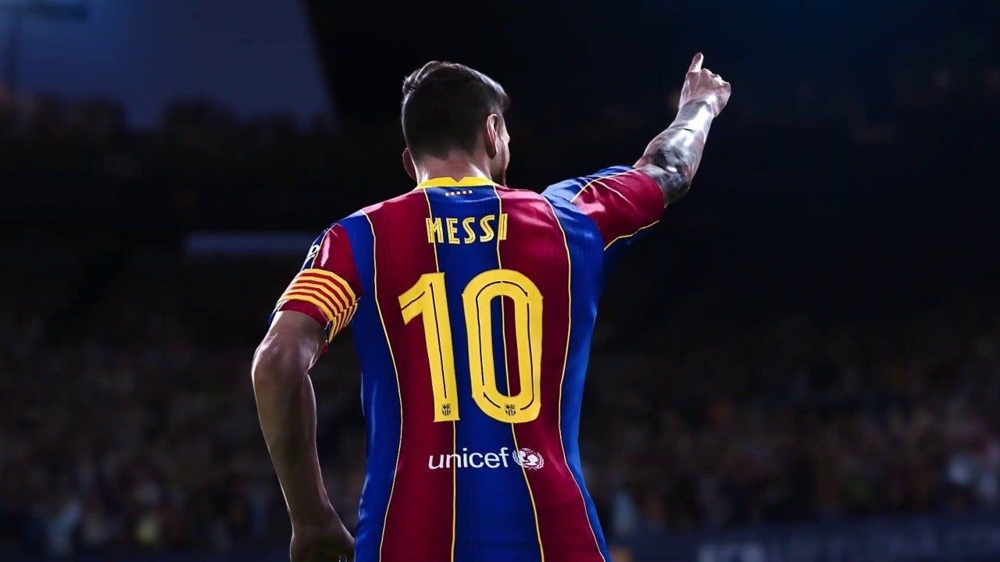

In [76]:
second_striker_df=pes_df[['name','overall_rating','rating_as_SS','nationality','team_name','foot','age']]
second_striker_df.sort_values('rating_as_SS',ascending=False).head(20)

,name,overall_rating,rating_as_SS,nationality,team_name,foot,age
0,L. MESSI,94,94,ARGENTINA,FC BARCELONA,Left foot,33
3,NEYMAR,92,90,BRAZIL,PSG,Right foot,28
1,C. RONALDO,93,89,PORTUGAL,JUVENTUS,Right foot,35
20,E. HAZARD,88,88,BELGIUM,MADRID CHAMARTIN B,Right foot,29
30,P. DYBALA,88,88,ARGENTINA,JUVENTUS,Left foot,27
7,K. MBAPPÉ,91,87,FRANCE,PSG,Right foot,22
57,T. MÜLLER,86,86,GERMANY,FC BAYERN MÜNCHEN,Right foot,31
28,R. STERLING,88,86,ENGLAND,MANCHESTER B,Right foot,26
60,J. ILIČIĆ,86,86,SLOVENIA,ATALANTA,Left foot,32
39,SON HEUNG-MIN,87,86,REPUBLIC OF KOREA,TOTTENHAM WB,Right foot,28


Lionel Messi is the highest rated second striker

## BEST CENTER FORWARDS/STRIKER


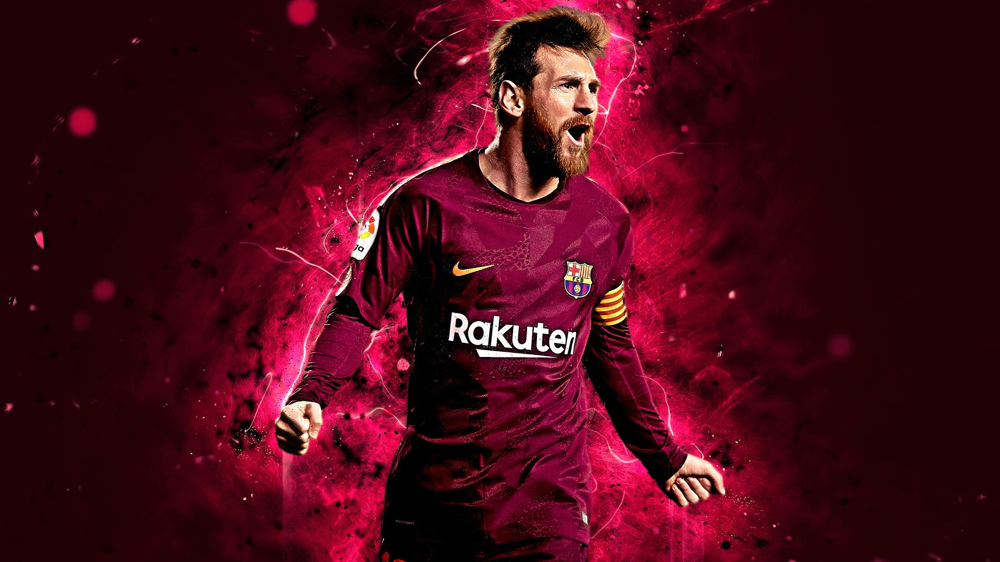

In [44]:
#FIND THE BEST STRIKERS
strikers_df=pes_df[['name','finishing','offensive_awareness','heading','rating_as_CF','nationality','team_name','foot','age']]
strikers_df.sort_values('rating_as_CF',ascending=False).head(20)

,name,finishing,offensive_awareness,heading,rating_as_CF,nationality,team_name,foot,age
0,L. MESSI,95,95,70,94,ARGENTINA,FC BARCELONA,Left foot,33
1,C. RONALDO,91,91,93,93,PORTUGAL,JUVENTUS,Right foot,35
2,R. LEWANDOWSKI,92,94,88,92,POLAND,FC BAYERN MÜNCHEN,Right foot,32
7,K. MBAPPÉ,87,88,77,91,FRANCE,PSG,Right foot,22
9,S. AGÜERO,93,93,78,90,ARGENTINA,MANCHESTER B,Right foot,32
15,H. KANE,93,93,87,89,ENGLAND,TOTTENHAM WB,Right foot,27
13,L. SUÁREZ,88,90,78,89,URUGUAY,FC BARCELONA,Right foot,33
18,K. BENZEMA,86,88,85,88,FRANCE,MADRID CHAMARTIN B,Right foot,33
22,P. AUBAMEYANG,88,92,80,88,GABON,ARSENAL,Right foot,31
37,C. IMMOBILE,91,90,87,87,ITALY,LAZIO,Right foot,30


Messi is the best striker

Find out who the best under 30 striker


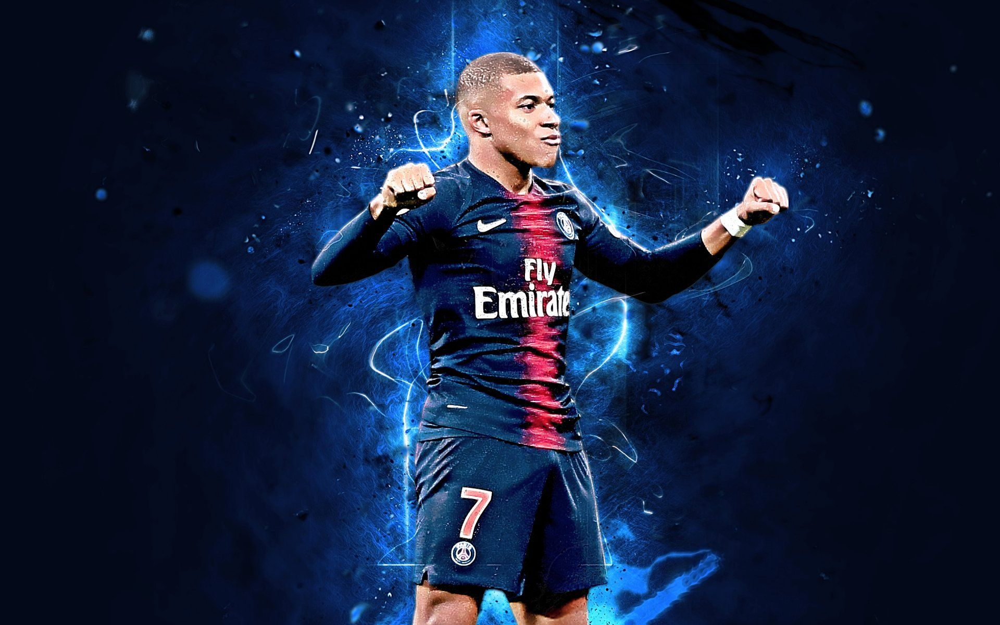

In [74]:

#BEST STRIKERS BELOW 30
striker_30=strikers_df[strikers_df.age<30]
striker_30.sort_values('rating_as_CF',ascending=False).head(30)


,name,overall_rating,rating_as_CF,nationality,team_name,foot,age
7,K. MBAPPÉ,91,91,FRANCE,PSG,Right foot,22
15,H. KANE,89,89,ENGLAND,TOTTENHAM WB,Right foot,27
25,A. GRIEZMANN,88,87,FRANCE,FC BARCELONA,Left foot,29
47,ROBERTO FIRMINO,87,87,BRAZIL,LIVERPOOL R,Right foot,29
56,R. LUKAKU,86,86,BELGIUM,LOMBARDIA NA,Left foot,27
63,M. ICARDI,86,86,ARGENTINA,PSG,Right foot,27
77,T. WERNER,86,86,GERMANY,CHELSEA B,Right foot,24
105,M. DEPAY,85,85,NETHERLANDS,OLYMPIQUE LYONNAIS,Right foot,26
107,R. JIMÉNEZ,85,85,MEXICO,WOLVERHAMPTON YB,Right foot,29
114,GABRIEL JESUS,85,85,BRAZIL,MANCHESTER B,Right foot,23


Mbappe is the best under 30 striker 

## BEST MIDFIELDERS

BEST CENTRAL MIDFIELDERS

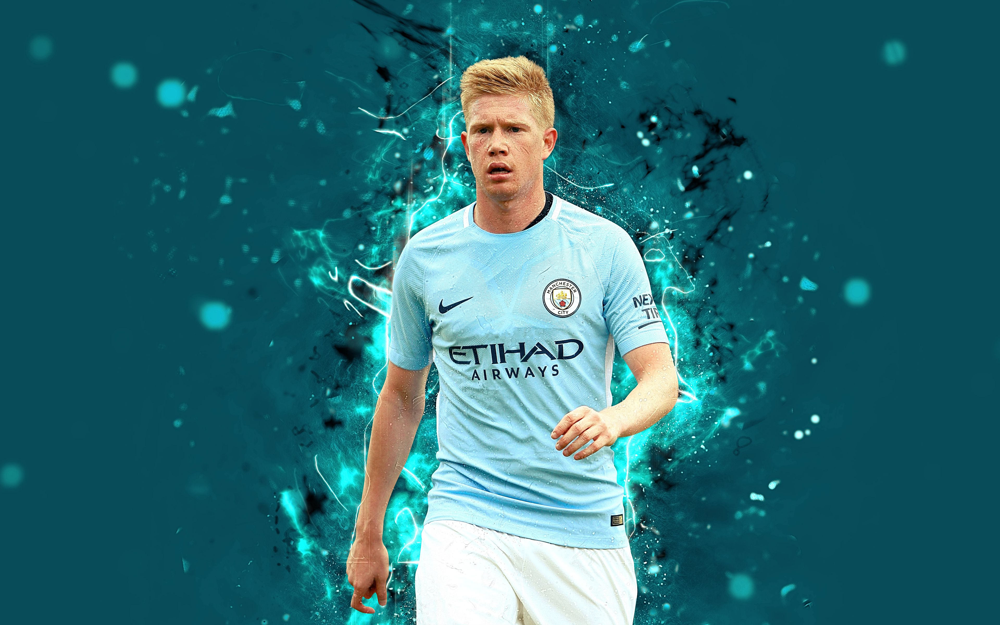

In [79]:
midfielders_df=pes_df[['name','overall_rating','rating_as_CMF','nationality','team_name','foot','age']]
midfielders_df.sort_values('rating_as_CMF',ascending=False).head(20)

,name,overall_rating,rating_as_CMF,nationality,team_name,foot,age
4,K. DE BRUYNE,92,91,BELGIUM,MANCHESTER B,Right foot,29
31,N. KANTÉ,88,88,FRANCE,CHELSEA B,Right foot,29
24,THIAGO,88,88,SPAIN,FC BAYERN MÜNCHEN,Right foot,29
19,T. KROOS,88,88,GERMANY,MADRID CHAMARTIN B,Right foot,30
41,M. VERRATTI,87,87,ITALY,PSG,Right foot,28
44,SAÚL,87,87,SPAIN,MADRID ROSAS RB,Left foot,26
48,F. DE JONG,87,87,NETHERLANDS,FC BARCELONA,Right foot,23
73,S. MILINKOVIĆ-SAVIĆ,86,86,SERBIA,LAZIO,Right foot,25
46,BERNARDO SILVA,87,86,PORTUGAL,MANCHESTER B,Left foot,26
52,L. MODRIĆ,86,86,CROATIA,MADRID CHAMARTIN B,Right foot,35


Kevin Debruyne is the best central midfielder

##BEST ATTACKING MIDFIELDERS

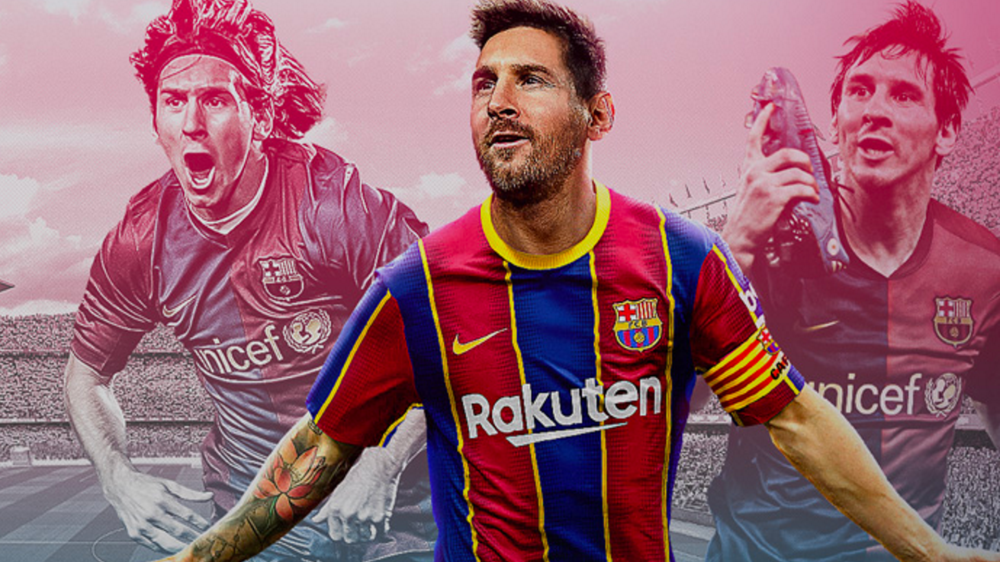

In [81]:
#BEST ATTACKING MIDFIELDERS
attacking_midfielders_df=pes_df[['name','overall_rating','rating_as_AMF','nationality','team_name','foot','age']]
attacking_midfielders_df.sort_values('rating_as_AMF',ascending=False).head(20)

,name,overall_rating,rating_as_AMF,nationality,team_name,foot,age
0,L. MESSI,94,94,ARGENTINA,FC BARCELONA,Left foot,33
4,K. DE BRUYNE,92,92,BELGIUM,MANCHESTER B,Right foot,29
3,NEYMAR,92,91,BRAZIL,PSG,Right foot,28
20,E. HAZARD,88,88,BELGIUM,MADRID CHAMARTIN B,Right foot,29
60,J. ILIČIĆ,86,87,SLOVENIA,ATALANTA,Left foot,32
46,BERNARDO SILVA,87,87,PORTUGAL,MANCHESTER B,Left foot,26
1,C. RONALDO,93,87,PORTUGAL,JUVENTUS,Right foot,35
25,A. GRIEZMANN,88,87,FRANCE,FC BARCELONA,Left foot,29
42,BRUNO FERNANDES,87,87,PORTUGAL,MANCHESTER UNITED,Right foot,26
64,H. ZIYECH,86,86,MOROCCO,CHELSEA B,Left foot,27


Messi is the best attacking midfielder but kevin isnt far behind

## Best left midfielders

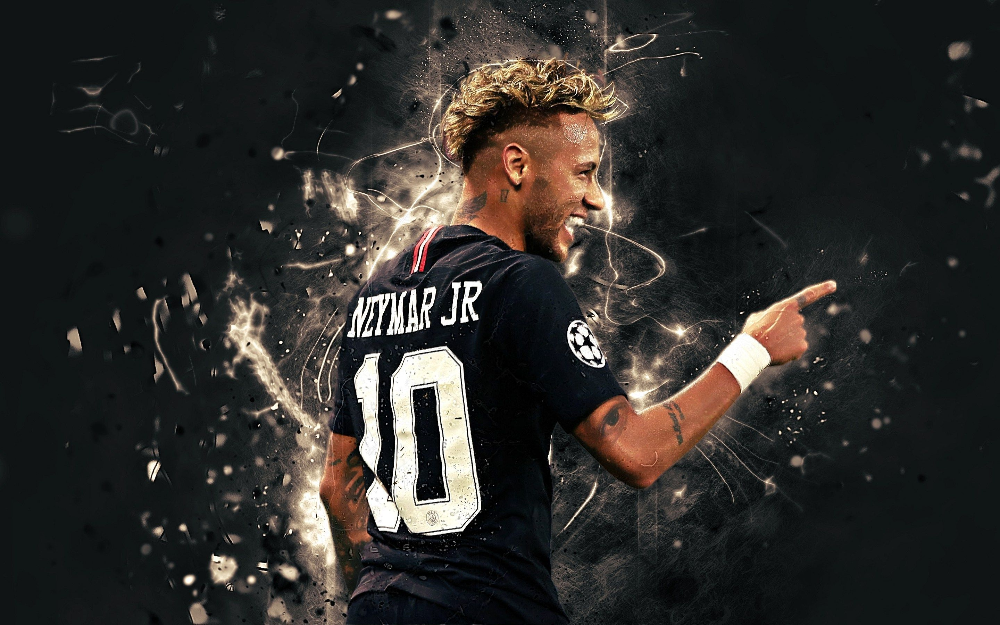

In [73]:
#Best left midfielders
left_midfielder_df=pes_df[['name','overall_rating','rating_as_LMF','nationality','team_name','foot','age']]
left_midfielder_df.sort_values('rating_as_LMF',ascending=False).head(20)

,name,overall_rating,rating_as_LMF,nationality,team_name,foot,age
3,NEYMAR,92,89,BRAZIL,PSG,Right foot,28
7,K. MBAPPÉ,91,88,FRANCE,PSG,Right foot,22
39,SON HEUNG-MIN,87,87,REPUBLIC OF KOREA,TOTTENHAM WB,Right foot,28
20,E. HAZARD,88,87,BELGIUM,MADRID CHAMARTIN B,Right foot,29
28,R. STERLING,88,86,ENGLAND,MANCHESTER B,Right foot,26
1,C. RONALDO,93,86,PORTUGAL,JUVENTUS,Right foot,35
10,S. MANÉ,90,86,SENEGAL,LIVERPOOL R,Right foot,28
78,J. SANCHO,86,85,ENGLAND,Free Agents,Right foot,20
117,O. DEMBÉLÉ,85,84,FRANCE,FC BARCELONA,Right foot,23
151,MIKEL OYARZABAL,84,84,SPAIN,VASCO GIPUZKOA AB,Left foot,23


Neymar is the highest rated  left midfielder 

## BEST RIGHT MIDFIELDER

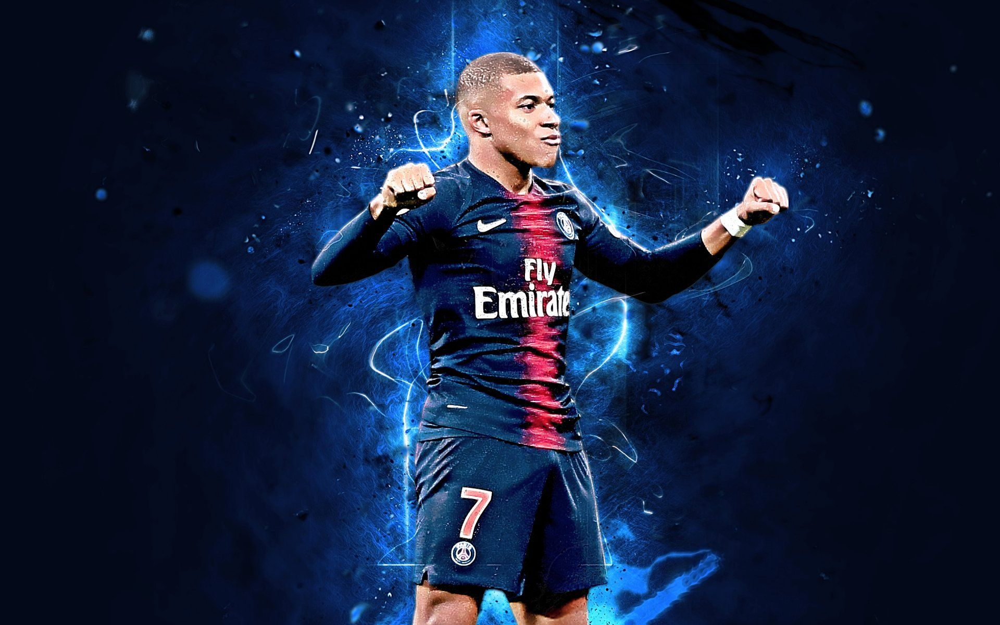

In [74]:
right_midfielder_df=pes_df[['name','overall_rating','rating_as_RMF','nationality','team_name','foot','age']]
right_midfielder_df.sort_values('rating_as_RMF',ascending=False).head(20)

,name,overall_rating,rating_as_RMF,nationality,team_name,foot,age
7,K. MBAPPÉ,91,88,FRANCE,PSG,Right foot,22
0,L. MESSI,94,87,ARGENTINA,FC BARCELONA,Left foot,33
3,NEYMAR,92,87,BRAZIL,PSG,Right foot,28
1,C. RONALDO,93,86,PORTUGAL,JUVENTUS,Right foot,35
28,R. STERLING,88,86,ENGLAND,MANCHESTER B,Right foot,26
10,S. MANÉ,90,86,SENEGAL,LIVERPOOL R,Right foot,28
16,M. SALAH,89,85,EGYPT,LIVERPOOL R,Left foot,28
117,O. DEMBÉLÉ,85,84,FRANCE,FC BARCELONA,Right foot,23
148,N. PÉPÉ,84,84,CÔTE D'IVOIRE,ARSENAL,Left foot,25
43,S. GNABRY,87,84,GERMANY,FC BAYERN MÜNCHEN,Right foot,25


Kylian Mbappe is the highest rated right midfielder

## BEST DEFENSIVE MIDFIELDER

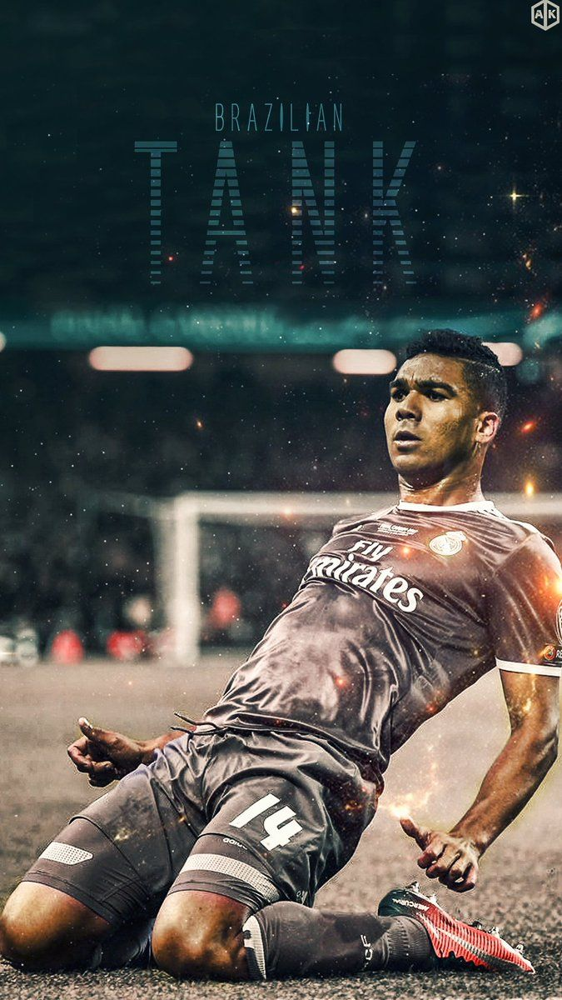

In [84]:
defensive_midfielders_df=pes_df[['name','overall_rating','rating_as_DMF','nationality','team_name','foot','age']]
defensive_midfielders_df.sort_values('rating_as_DMF',ascending=False).head(20)

,name,overall_rating,rating_as_DMF,nationality,team_name,foot,age
14,CASEMIRO,89,89,BRAZIL,MADRID CHAMARTIN B,Right foot,28
21,BUSQUETS,88,88,SPAIN,FC BARCELONA,Right foot,32
32,J. KIMMICH,88,88,GERMANY,FC BAYERN MÜNCHEN,Right foot,25
40,MARQUINHOS,87,87,BRAZIL,PSG,Right foot,26
38,D. ALABA,87,87,AUSTRIA,FC BAYERN MÜNCHEN,Left foot,28
19,T. KROOS,88,86,GERMANY,MADRID CHAMARTIN B,Right foot,30
41,M. VERRATTI,87,86,ITALY,PSG,Right foot,28
53,M. PJANIĆ,86,86,BOSNIA AND HERZEGOVINA,FC BARCELONA,Right foot,30
4,K. DE BRUYNE,92,86,BELGIUM,MANCHESTER B,Right foot,29
69,FABINHO,86,86,BRAZIL,LIVERPOOL R,Right foot,27


Casemiro is the highest rated defensive midfielder

## BEST DEFENDERS

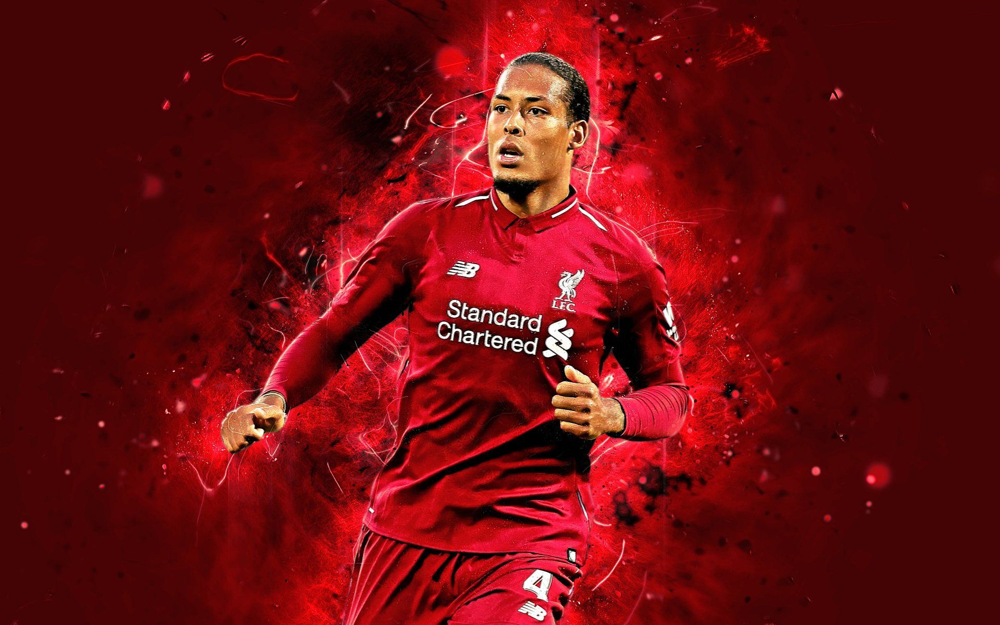

In [85]:
defenders_df=pes_df[['name','overall_rating','rating_as_CB','nationality','team_name','foot','age']]
defenders_df.sort_values('rating_as_CB',ascending=False).head(20)

,name,overall_rating,rating_as_CB,nationality,team_name,foot,age
6,V. VAN DIJK,91,91,NETHERLANDS,LIVERPOOL R,Right foot,29
8,SERGIO RAMOS,90,90,SPAIN,MADRID CHAMARTIN B,Right foot,34
26,R. VARANE,88,88,FRANCE,MADRID CHAMARTIN B,Right foot,27
38,D. ALABA,87,87,AUSTRIA,FC BAYERN MÜNCHEN,Left foot,28
45,K. KOULIBALY,87,87,SENEGAL,NAPOLI,Right foot,29
40,MARQUINHOS,87,87,BRAZIL,PSG,Right foot,26
33,PIQUÉ,87,87,SPAIN,FC BARCELONA,Right foot,33
75,M. DE LIGT,86,86,NETHERLANDS,JUVENTUS,Right foot,21
74,M. ŠKRINIAR,86,86,SLOVAKIA,LOMBARDIA NA,Right foot,25
72,C. LENGLET,86,86,FRANCE,FC BARCELONA,Left foot,25


Van Dijk is the highest rated center back

## BEST LEFTBACK

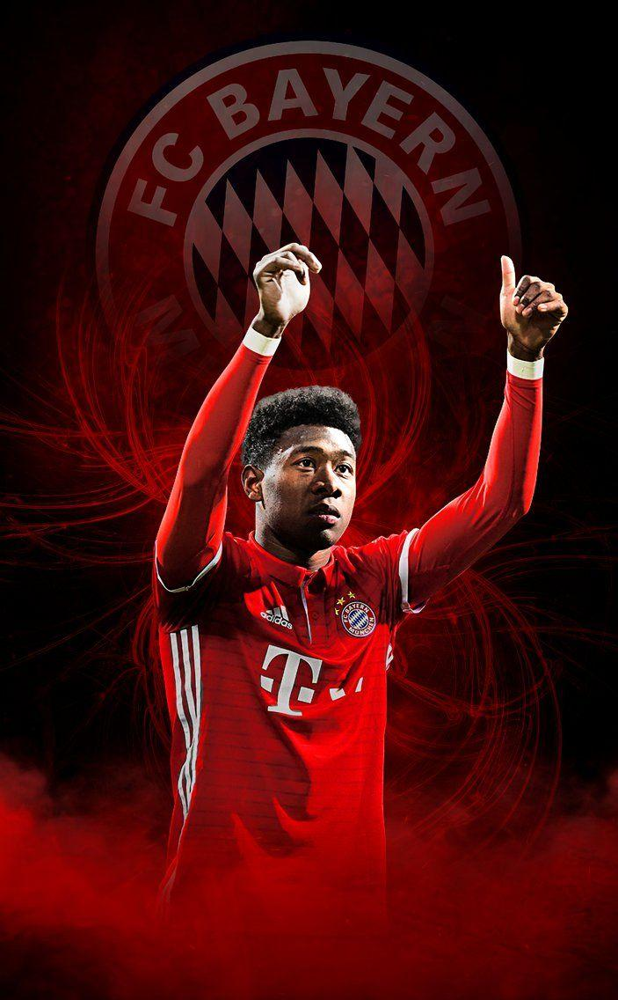

In [87]:
left_backs_df=pes_df[['name','overall_rating','rating_as_LB','nationality','team_name','foot','age']]
left_backs_df.sort_values('rating_as_LB',ascending=False).head(20)

,name,overall_rating,rating_as_LB,nationality,team_name,foot,age
38,D. ALABA,87,87,AUSTRIA,FC BAYERN MÜNCHEN,Left foot,28
111,A. ROBERTSON,85,85,SCOTLAND,LIVERPOOL R,Left foot,26
93,JORDI ALBA,85,85,SPAIN,FC BARCELONA,Left foot,31
130,N. TAGLIAFICO,84,84,ARGENTINA,AJAX,Left foot,28
133,ALEX SANDRO,84,84,BRAZIL,JUVENTUS,Left foot,29
230,F. MENDY,83,83,FRANCE,MADRID CHAMARTIN B,Left foot,25
165,MARCELO,83,83,BRAZIL,MADRID CHAMARTIN B,Left foot,32
204,ALEX TELLES,83,83,BRAZIL,PORTO,Left foot,28
31,N. KANTÉ,88,83,FRANCE,CHELSEA B,Right foot,29
172,A. KOLAROV,83,83,SERBIA,ROMA,Left foot,35


David Alaba is the highest rated left back

## BEST RIGHT BACK

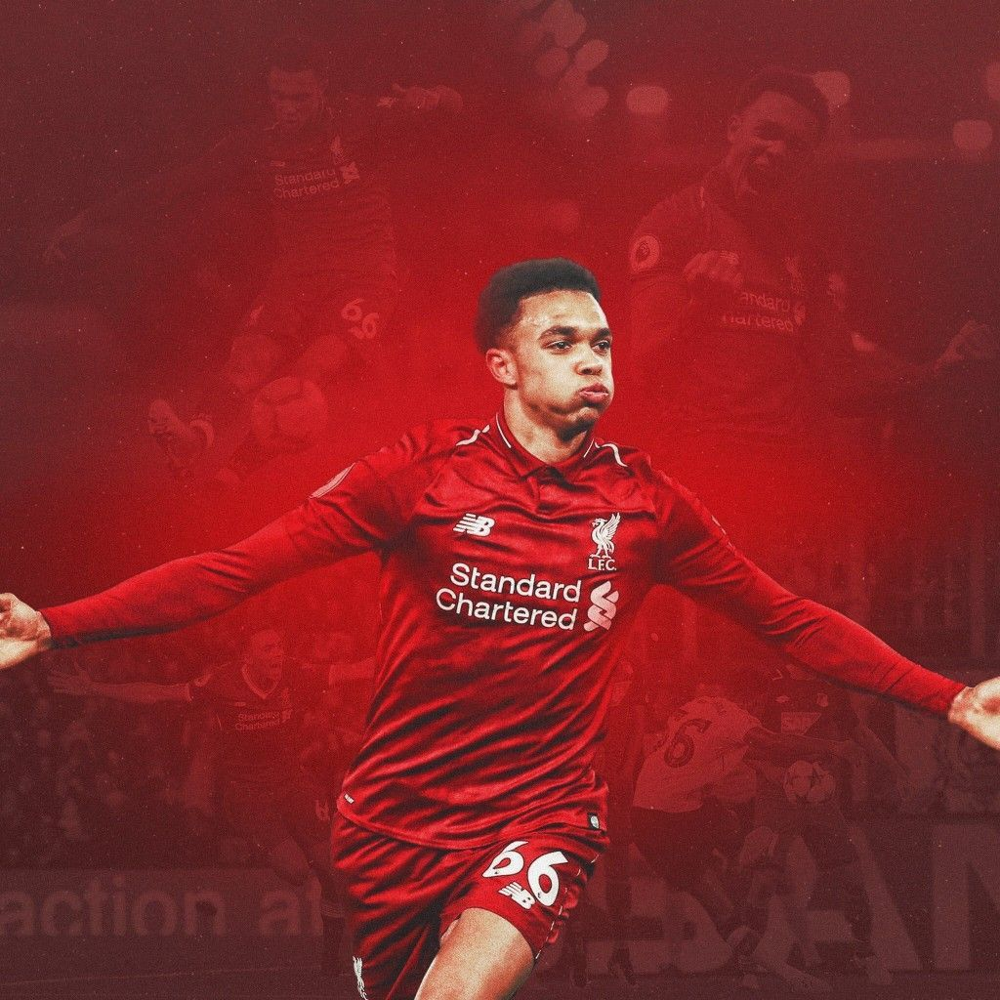

In [88]:
right_backs_df=pes_df[['name','overall_rating','rating_as_RB','nationality','team_name','foot','age']]
right_backs_df.sort_values('rating_as_RB',ascending=False).head(20)

,name,overall_rating,rating_as_RB,nationality,team_name,foot,age
49,T. ALEXANDER-ARNOLD,87,87,ENGLAND,LIVERPOOL R,Right foot,22
108,CARVAJAL,85,85,SPAIN,MADRID CHAMARTIN B,Right foot,28
38,D. ALABA,87,85,AUSTRIA,FC BAYERN MÜNCHEN,Left foot,28
40,MARQUINHOS,87,84,BRAZIL,PSG,Right foot,26
136,RICARDO PEREIRA,84,84,PORTUGAL,LEICESTER B,Right foot,27
190,SERGI ROBERTO,83,83,SPAIN,FC BARCELONA,Right foot,28
31,N. KANTÉ,88,83,FRANCE,CHELSEA B,Right foot,29
240,A. WAN-BISSAKA,83,83,ENGLAND,MANCHESTER UNITED,Right foot,23
237,A. HAKIMI,83,83,MOROCCO,LOMBARDIA NA,Right foot,22
234,NÉLSON SEMEDO,83,83,PORTUGAL,FC BARCELONA,Right foot,27


Trent Alexander is the highest rated right back

## BEST GOALKEEPRS

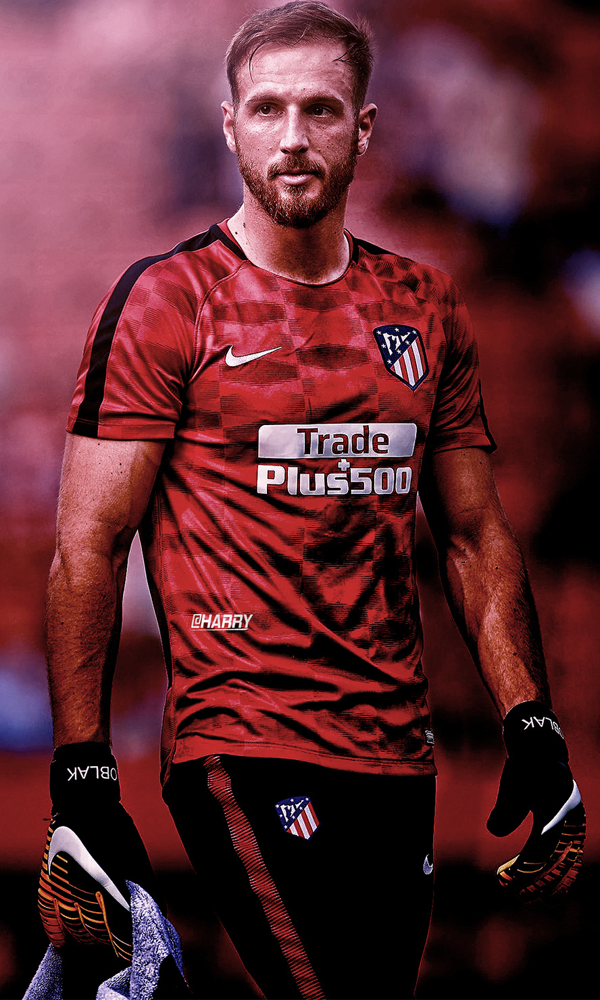

In [89]:
#BEST GOALKEEPERS
goalkeeper_df=pes_df[['name','overall_rating','rating_as_GK','nationality','team_name','foot','age']]
goalkeeper_df.sort_values('rating_as_GK',ascending=False).head(20)

,name,overall_rating,rating_as_GK,nationality,team_name,foot,age
5,J. OBLAK,91,91,SLOVENIA,MADRID ROSAS RB,Right foot,27
11,ALISSON,90,90,BRAZIL,LIVERPOOL R,Right foot,28
17,M. TER STEGEN,89,89,GERMANY,FC BARCELONA,Right foot,28
12,M. NEUER,89,89,GERMANY,FC BAYERN MÜNCHEN,Right foot,34
29,EDERSON,88,88,BRAZIL,MANCHESTER B,Left foot,27
27,T. COURTOIS,88,88,BELGIUM,MADRID CHAMARTIN B,Left foot,28
23,DAVID DE GEA,88,88,SPAIN,MANCHESTER UNITED,Right foot,30
34,S. HANDANOVIČ,87,87,SLOVENIA,LOMBARDIA NA,Right foot,36
36,W. SZCZĘSNY,87,87,POLAND,JUVENTUS,Right foot,30
62,B. LENO,86,86,GERMANY,ARSENAL,Right foot,28


Jan oblak is just the best goalkeeper

   ## Deadliest Finishers

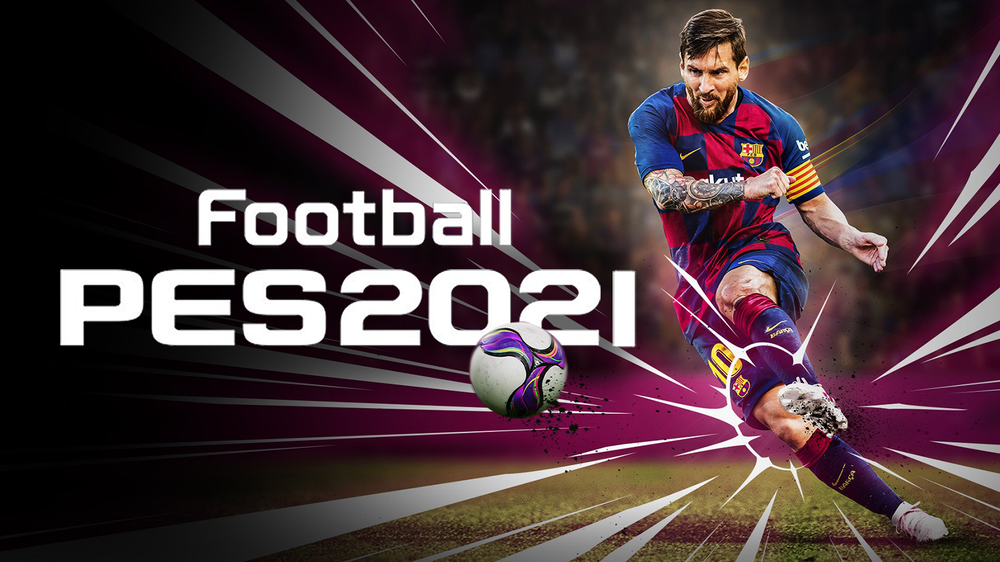

In [16]:
deadly_df=pes_df[['name','overall_rating','finishing','nationality','team_name','foot','age']]
deadly_df.sort_values('finishing',ascending=False).head(20)

,name,overall_rating,finishing,nationality,team_name,foot,age
0,L. MESSI,94,95,ARGENTINA,FC BARCELONA,Left foot,33
9,S. AGÜERO,90,93,ARGENTINA,MANCHESTER B,Right foot,32
15,H. KANE,89,93,ENGLAND,TOTTENHAM WB,Right foot,27
2,R. LEWANDOWSKI,92,92,POLAND,FC BAYERN MÜNCHEN,Right foot,32
37,C. IMMOBILE,87,91,ITALY,LAZIO,Right foot,30
1,C. RONALDO,93,91,PORTUGAL,JUVENTUS,Right foot,35
22,P. AUBAMEYANG,88,88,GABON,ARSENAL,Right foot,31
139,D. ZAPATA,84,88,COLOMBIA,ATALANTA,Right foot,29
13,L. SUÁREZ,89,88,URUGUAY,FC BARCELONA,Right foot,33
82,G. HIGUAÍN,85,87,ARGENTINA,JUVENTUS,Right foot,33


of course messi is the deadliest

## BEST HEADER

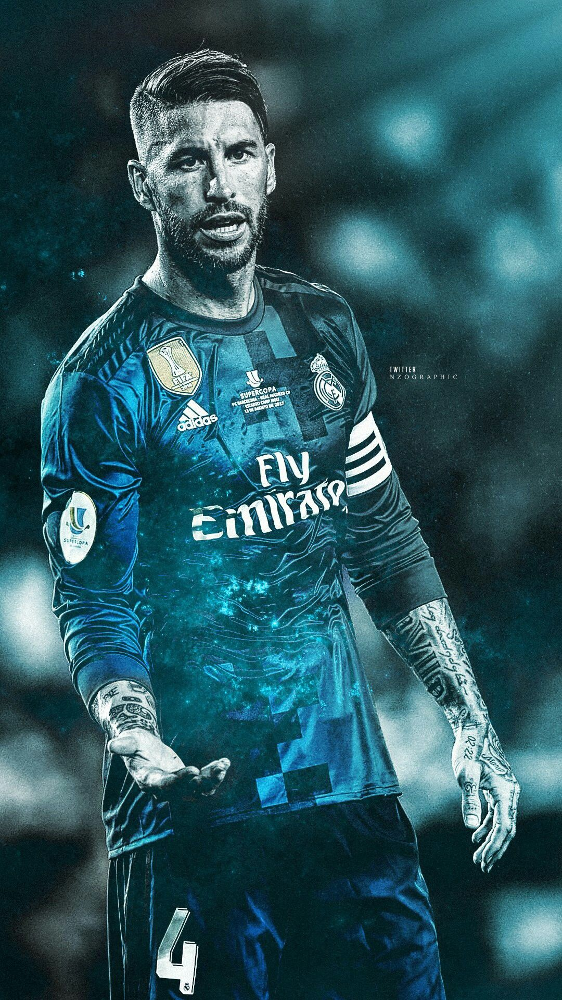

In [28]:
header_df=pes_df[['name','overall_rating','heading','physical_contact','height','nationality','team_name','foot','age']]
header_df.sort_values('heading',ascending=False).head(20)

,name,overall_rating,heading,physical_contact,height,nationality,team_name,foot,age
8,SERGIO RAMOS,90,94,85,184,SPAIN,MADRID CHAMARTIN B,Right foot,34
656,L. DE JONG,79,93,84,188,NETHERLANDS,SEVILLA NERVIÓN BR,Right foot,30
1,C. RONALDO,93,93,87,187,PORTUGAL,JUVENTUS,Right foot,35
76,N. SÜLE,86,92,92,195,GERMANY,FC BAYERN MÜNCHEN,Right foot,25
169,A. DZYUBA,83,92,95,196,RUSSIA,ZENIT,Right foot,32
6,V. VAN DIJK,91,92,94,193,NETHERLANDS,LIVERPOOL R,Right foot,29
257,O. GIROUD,82,92,91,192,FRANCE,CHELSEA B,Left foot,34
634,LLORENTE,79,91,89,193,SPAIN,NAPOLI,Right foot,35
335,J. TAH,82,90,91,195,GERMANY,BAYER LEVERKUSEN,Right foot,24
124,JAVI MARTÍNEZ,84,90,87,190,SPAIN,FC BAYERN MÜNCHEN,Right foot,32


Sergio Ramos is the best header in the game 

## WHO IS THE BEAST

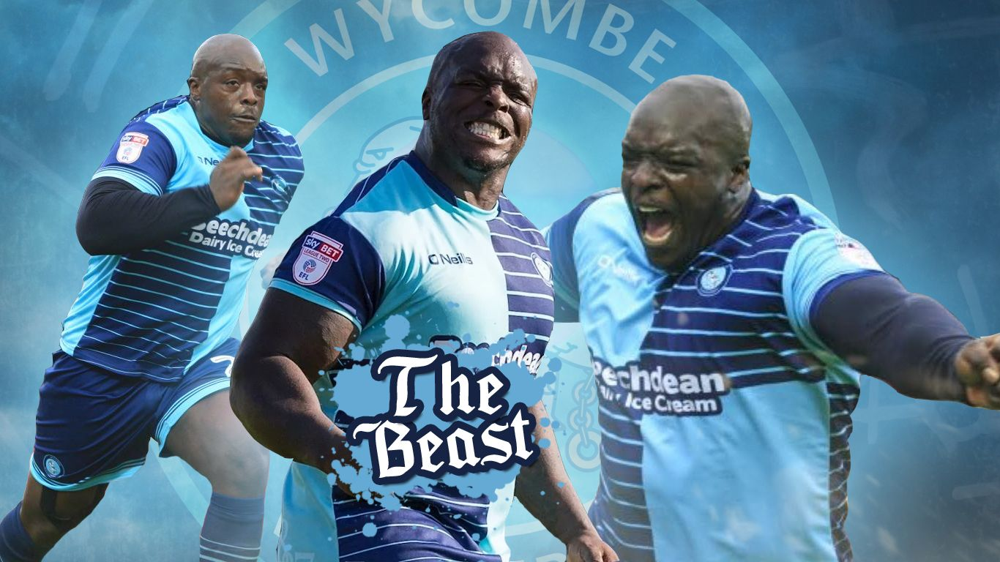

In [30]:
beast_df=pes_df[['name','overall_rating','physical_contact','heading','height','nationality','team_name','foot','age']]
beast_df.sort_values('physical_contact',ascending=False).head(20)

,name,overall_rating,physical_contact,heading,height,nationality,team_name,foot,age
10329,A. AKINFENWA,65,97,71,178,ENGLAND,WYCOMBE B,Right foot,38
169,A. DZYUBA,83,95,92,196,RUSSIA,ZENIT,Right foot,32
56,R. LUKAKU,86,95,86,191,BELGIUM,LOMBARDIA NA,Left foot,27
1056,J. VESTERGAARD,78,95,87,199,DENMARK,SOUTHAMPTON RW,Right foot,28
6,V. VAN DIJK,91,94,92,193,NETHERLANDS,LIVERPOOL R,Right foot,29
116,H. MAGUIRE,85,94,88,194,ENGLAND,MANCHESTER UNITED,Right foot,27
45,K. KOULIBALY,87,93,88,187,SENEGAL,NAPOLI,Right foot,29
2081,D. BURN,75,93,78,198,ENGLAND,BRIGHTON WB,Left foot,28
926,L. UNNERSTALL,78,92,72,198,GERMANY,PSV,Right foot,30
526,W. BOLY,80,92,84,195,FRANCE,WOLVERHAMPTON YB,Right foot,29


Akinfewnwa is a physical beast but not the best target man due to his lack of height

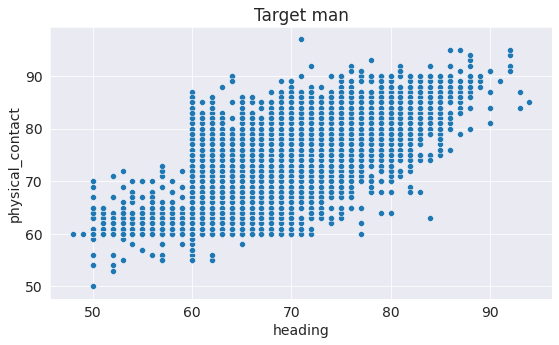

In [71]:
plt.title('Target man')
sns.scatterplot(x=target_df.heading,y=target_df.physical_contact);

The graph is to show the correlation between Physical presence and heading and based on it we can see that the higher the physical contact the better the player is at heading and hence a good target man in the box

Let us save and upload our work to Jovian before continuing.

In [2]:
import jovian

In [3]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Updating notebook "adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0" on https://jovian.ai
[jovian] Committed successfully! https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0


'https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0'

## Inferences and Conclusion



After the analysis I have come to some conclusions like;
There are 14693 players on PES21
The range in height(cm) is between 156 to 203
The range in weight(kg) is between 40 to 113
The average age is 25 years
Brazil is the country most represented with 1439 players
The fastest players are Mbappe and Adama
Majority of the fast players are below 30 
Black balled players are rare as the possibility of getting them is just 0.81%
Messi is the most skillful as his dribbling and ball control are the highest rated
Mbappe is the best under 30 striker
Messi is the best striker 
c.Ronaldo is the best left winger
Messi is the best right winger
Messi is the best second striker
kevin de bruyne is the best central midfielder
Messi is the best attacking midfielder
Neymar is the best left midfielder
Mbappe is the best right midfielder
Casemiro is the best defensive midfielder
Van Dijk is the best central defender
David Alaba ia the best left back
Trent Arnold is the best right back 
Jan Oblak is the best goalkeeper
Messi is the deadliest finisher
Sergio Ramos is the beast header
The beast is Akinfenwa


## THE BEST PLAYER IN THE GAME BASED ON THE ANALYSIS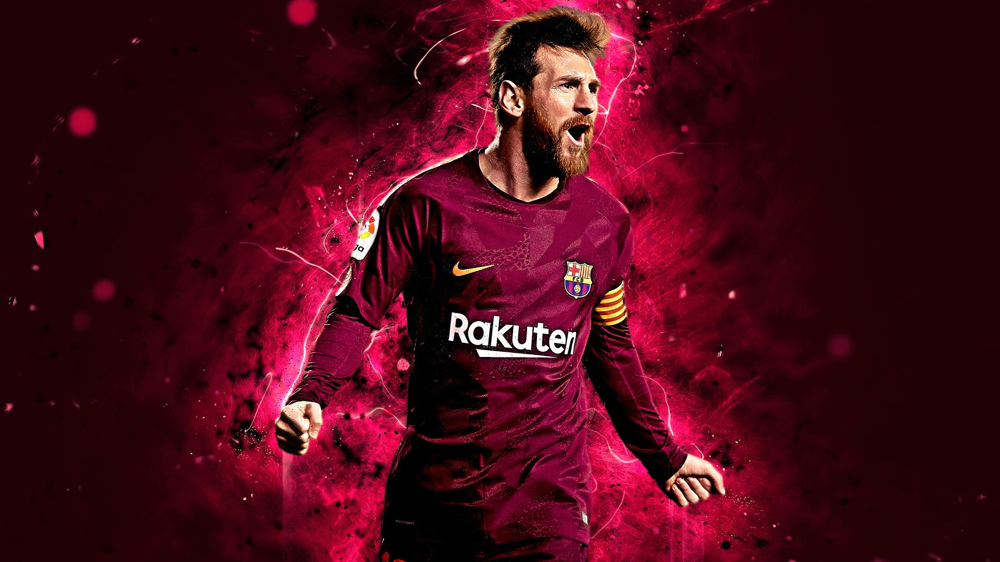

The best player is Lionel Messi based on the frequency of been the best in a lot of positions, which include:
-striker
-second striker
-attacking midfielder
-right winger

In [1]:
import jovian

In [2]:
jovian.commit()

<IPython.core.display.Javascript object>

[jovian] Updating notebook "adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0" on https://jovian.ai
[jovian] Committed successfully! https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0


'https://jovian.ai/adedoyinadegbite-s/efootball-pes2021-all-players-csv-898e0'

## References and Future Work


Thank you for the lessons and taking your time to create an easy guide to data analysis,I enjoyed every moment of it .This project is part of The  Course DATA ANALYSIS WITH PYTHON :ZERO_TO_PANDAS.And i want to say a big thank you to Aakash NS and the whole Jovian.ml team for this opportunity to learn data analysis

FUTURE WORK
There are a lot of places for improvement with data provided and adding extra datasets we can :
-Find out the best 11 based on style of play 
-Find the best coach based on players available
-Find the best style of play to ensure victory
-Compare Messi and christiano and find out who is the best 



## Refrences


-PES 21 :'https://www.kaggle.com/homerkommrad/efootball-pes2021-all-players-csv/version/1' 
-Kaggle Datasets (Choose Dataset of your choice): https://www.kaggle.com/datasets
-Pandas user guide: https://pandas.pydata.org/docs/user_guide/index.html
-Matplotlib user guide: https://matplotlib.org/3.3.1/users/index.html
-Seaborn user guide & tutorial: https://seaborn.pydata.org/tutorial.html
-Data analysis guide(https://jovian.ml/aakashns/python-pandas-data-analysis)
-Jovian Forum (Ask Questions in this great community): https://jovian.ml/forum/

In [5]:
import jovian

In [ ]:
jovian.commit()

<IPython.core.display.Javascript object>